In [1]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_log_error as msle
import lightgbm as lgb
import pycaret
from pycaret.regression import *
import optuna
import matplotlib.pyplot as plt
import warnings
warnings.filterwarnings('ignore')
optuna.logging.set_verbosity(optuna.logging.WARNING)

In [2]:
def rmsle(y_true, y_pred):
    
    msle = msle(y_true, y_pred)

    return np.sqrt(msle)

### Make datasets

In [113]:
df1 = pd.read_csv('train_features_added.csv').drop(['month','day','hour','day_of_year'], axis=1)
df2 = pd.read_csv('UCI_preprocessed.csv').drop(['month','day','hour','day_of_year'], axis=1)
df_test = pd.read_csv('test_features_added.csv').drop(['month','day','hour','day_of_year'], axis=1)

df = pd.concat([df1, df2], axis=0)
df.reset_index(drop=True)

df_scaler = df1.copy()
df_test_scaler = df_test.copy()

df_scaler_train, df_scaler_val = train_test_split(df_scaler, test_size=0.5, shuffle=False)

def format_date_time(df):

    df['date_time'] = pd.to_datetime(df['date_time'], format='%Y-%m-%d %H:%M:%S')

    return df


df_scaler = format_date_time(df_scaler)
df_scaler_train = format_date_time(df_scaler_train)
df_scaler_val = format_date_time(df_scaler_val)
df_test_scaler = format_date_time(df_test_scaler)

df.set_index('date_time', inplace=True)
df_test.set_index('date_time', inplace=True)

In [4]:
targets = ['target_carbon_monoxide', 'target_benzene', 'target_nitrogen_oxides']

def log_trans(df, features: 'list'):

    for i in features:

        df[i] = np.log1p(df[i])

    return df

df = log_trans(df, targets)

In [5]:
df_train, df_val = train_test_split(df, test_size=0.1, shuffle=False)
df_train1, df_train2 = train_test_split(df_train, test_size=0.5, shuffle=True)

df_train2_base = df_train2.drop(targets, axis=1)

categorical_features = ['day_of_week', 'weekend', 'working_hours']

### CO

##### Compare models

In [6]:
exp_CO = setup(df_train1, target=targets[0], train_size=0.8, data_split_shuffle=True, fold_shuffle=True, use_gpu=False, ignore_features=[targets[1], targets[2]], categorical_features=categorical_features, session_id=123)

,Description,Value
0,Session id,123
1,Target,target_carbon_monoxide
2,Target type,Regression
3,Original data shape,"(7240, 24)"
4,Transformed data shape,"(7240, 28)"
5,Transformed train set shape,"(5792, 28)"
6,Transformed test set shape,"(1448, 28)"
7,Ignore features,2
8,Ordinal features,2
9,Numeric features,18


In [7]:
models = compare_models(sort='RMSLE')

,Model,MAE,MSE,RMSE,R2,RMSLE,MAPE,TT (Sec)
catboost,CatBoost Regressor,0.0566,0.0063,0.0793,0.9660,0.0411,0.0712,0.5820
lightgbm,Light Gradient Boosting Machine,0.0624,0.0076,0.0868,0.9593,0.0451,0.0797,0.2190
et,Extra Trees Regressor,0.0622,0.0079,0.0890,0.9572,0.0459,0.0784,0.3190
xgboost,Extreme Gradient Boosting,0.0636,0.0079,0.0890,0.9571,0.0460,0.0795,0.0550
rf,Random Forest Regressor,0.0693,0.0098,0.0990,0.9470,0.0511,0.0885,0.6180
gbr,Gradient Boosting Regressor,0.0736,0.0106,0.1028,0.9430,0.0536,0.0963,0.3390
knn,K Neighbors Regressor,0.0932,0.0175,0.1320,0.9059,0.0681,0.1205,0.0190
ridge,Ridge Regression,0.0961,0.0184,0.1356,0.9008,0.0699,0.1288,0.0130
br,Bayesian Ridge,0.0960,0.0184,0.1356,0.9007,0.0699,0.1288,0.0140
lr,Linear Regression,0.0962,0.0184,0.1356,0.9007,0.0699,0.1289,0.1980


Processing:   0%|          | 0/85 [00:00<?, ?it/s]

##### Make base models

In [8]:
CO_catboost = create_model('catboost')
CO_xgboost = create_model('xgboost')
CO_lightgbm = create_model('lightgbm')
CO_extratrees= create_model('et')
CO_randomforest = create_model('rf')
CO_gradientboost = create_model('gbr')

,MAE,MSE,RMSE,R2,RMSLE,MAPE
Fold,,,,,,
0,0.0553,0.0061,0.0778,0.9682,0.0399,0.0666
1,0.0593,0.0066,0.0812,0.9655,0.0428,0.0766
2,0.0556,0.0058,0.0763,0.9689,0.0378,0.0629
3,0.0540,0.0066,0.0815,0.9630,0.0441,0.0728
4,0.0584,0.0070,0.0838,0.9611,0.0424,0.0677
5,0.0588,0.0064,0.0799,0.9654,0.0398,0.0686
6,0.0554,0.0066,0.0813,0.9638,0.0435,0.0733
7,0.0585,0.0074,0.0863,0.9623,0.0456,0.0824
8,0.0535,0.0049,0.0699,0.9713,0.0359,0.0662


,MAE,MSE,RMSE,R2,RMSLE,MAPE
Fold,,,,,,
0,0.0613,0.0072,0.0850,0.9620,0.0432,0.0723
1,0.0629,0.0074,0.0861,0.9612,0.0452,0.0805
2,0.0652,0.0077,0.0877,0.9589,0.0432,0.0729
3,0.0618,0.0083,0.0912,0.9537,0.0492,0.0836
4,0.0635,0.0076,0.0874,0.9577,0.0445,0.0733
5,0.0668,0.0094,0.0969,0.9491,0.0480,0.0781
6,0.0624,0.0090,0.0948,0.9507,0.0505,0.0847
7,0.0646,0.0087,0.0932,0.9560,0.0486,0.0881
8,0.0611,0.0067,0.0821,0.9604,0.0419,0.0727


,MAE,MSE,RMSE,R2,RMSLE,MAPE
Fold,,,,,,
0,0.0606,0.0071,0.0845,0.9624,0.0427,0.0718
1,0.0635,0.0077,0.0878,0.9596,0.0466,0.0830
2,0.0633,0.0073,0.0855,0.9609,0.0427,0.0731
3,0.0592,0.0077,0.0875,0.9574,0.0474,0.0815
4,0.0616,0.0075,0.0865,0.9586,0.0439,0.0716
5,0.0645,0.0081,0.0900,0.9561,0.0453,0.0766
6,0.0630,0.0084,0.0914,0.9542,0.0485,0.0851
7,0.0629,0.0085,0.0920,0.9571,0.0489,0.0925
8,0.0604,0.0062,0.0788,0.9636,0.0403,0.0740


,MAE,MSE,RMSE,R2,RMSLE,MAPE
Fold,,,,,,
0,0.0613,0.0078,0.0883,0.9589,0.0443,0.0733
1,0.0619,0.0073,0.0856,0.9616,0.0438,0.0770
2,0.0617,0.0076,0.0874,0.9592,0.0438,0.0721
3,0.0611,0.0087,0.0931,0.9517,0.0504,0.0827
4,0.0618,0.0082,0.0903,0.9548,0.0457,0.0717
5,0.0629,0.0081,0.0900,0.9562,0.0447,0.0738
6,0.0630,0.0086,0.0928,0.9528,0.0494,0.0818
7,0.0641,0.0089,0.0944,0.9548,0.0491,0.0897
8,0.0594,0.0065,0.0803,0.9621,0.0412,0.0722


,MAE,MSE,RMSE,R2,RMSLE,MAPE
Fold,,,,,,
0,0.0670,0.0093,0.0963,0.9512,0.0484,0.0799
1,0.0694,0.0094,0.0967,0.9510,0.0501,0.0887
2,0.0705,0.0101,0.1003,0.9462,0.0502,0.0823
3,0.0670,0.0100,0.0999,0.9444,0.0540,0.0923
4,0.0693,0.0105,0.1026,0.9417,0.0515,0.0823
5,0.0695,0.0099,0.0995,0.9465,0.0497,0.0830
6,0.0723,0.0110,0.1047,0.9399,0.0549,0.0952
7,0.0709,0.0112,0.1058,0.9433,0.0552,0.1028
8,0.0650,0.0079,0.0891,0.9533,0.0455,0.0783


,MAE,MSE,RMSE,R2,RMSLE,MAPE
Fold,,,,,,
0,0.0713,0.0102,0.1011,0.9463,0.0510,0.0858
1,0.0754,0.0107,0.1035,0.9439,0.0538,0.0977
2,0.0746,0.0106,0.1028,0.9434,0.0525,0.0897
3,0.0702,0.0105,0.1023,0.9417,0.0553,0.0987
4,0.0717,0.0107,0.1036,0.9406,0.0514,0.0847
5,0.0752,0.0104,0.1022,0.9435,0.0523,0.0929
6,0.0746,0.0109,0.1045,0.9401,0.0560,0.1014
7,0.0751,0.0126,0.1121,0.9364,0.0592,0.1126
8,0.0717,0.0089,0.0946,0.9475,0.0494,0.0914


In [9]:
CO_catboost = finalize_model(CO_catboost)
CO_xgboost = finalize_model(CO_xgboost)
CO_lightgbm = finalize_model(CO_lightgbm)
CO_extratrees= finalize_model(CO_extratrees)
CO_randomforest = finalize_model(CO_randomforest)
CO_gradientboost = finalize_model(CO_gradientboost)

##### Make train data for metamodel

In [49]:
predict_CO_catboost = predict_model(CO_catboost, data=df_train2_base).prediction_label.tolist()
predict_CO_xgboost = predict_model(CO_xgboost, data=df_train2_base).prediction_label.tolist()
predict_CO_lightgbm = predict_model(CO_lightgbm, data=df_train2_base).prediction_label.tolist()
predict_CO_extratrees = predict_model(CO_extratrees, data=df_train2_base).prediction_label.tolist()
predict_CO_randomforest = predict_model(CO_randomforest, data=df_train2_base).prediction_label.tolist()
predict_CO_gradientboost = predict_model(CO_gradientboost, data=df_train2_base).prediction_label.tolist()

target_carbon_monoxide = df_train2.target_carbon_monoxide.tolist()

data = {'cb':predict_CO_catboost, 'xgb':predict_CO_xgboost, 'lgbm':predict_CO_lightgbm, 'et':predict_CO_extratrees, 'rf':predict_CO_randomforest, 'gbr':predict_CO_gradientboost, 'target_carbon_monoxide':target_carbon_monoxide}
CO_meta_df = pd.DataFrame(data)


In [50]:
CO_meta_df

,cb,xgb,lgbm,et,rf,gbr,target_carbon_monoxide
0,1.680720,1.648748,1.608797,1.641010,1.610696,1.597623,1.740466
1,1.241113,1.176101,1.229569,1.178117,1.138326,1.179359,1.223775
2,0.859760,0.839291,0.878366,0.876683,0.911333,0.839999,0.916291
3,1.366682,1.352191,1.331678,1.337653,1.328763,1.364896,1.410987
4,1.018516,0.974098,1.012042,0.956249,0.957753,0.976227,0.993252
...,...,...,...,...,...,...,...
7235,0.624421,0.622025,0.608108,0.599541,0.592955,0.662593,0.587787
7236,0.879322,0.866558,0.882160,0.936848,0.929471,0.876443,0.832909
7237,1.209171,1.241849,1.223851,1.166639,1.170188,1.159126,1.131402
7238,0.255052,0.237769,0.288759,0.244107,0.252874,0.328730,0.182322


##### Make metamodel

In [52]:
CO_meta_train, CO_meta_val = train_test_split(CO_meta_df, test_size=0.2, shuffle=False)

CO_meta_train_y = CO_meta_train[targets[0]]
CO_meta_train_x = CO_meta_train.drop(targets[0], axis=1)
CO_meta_val_y = CO_meta_val[targets[0]]
CO_meta_val_x = CO_meta_val.drop(targets[0], axis=1)

In [57]:
# OptunaによるlightGBMの最適パラメータ探索
def objective(trial):

    lgb_trains = lgb.Dataset(CO_meta_train_x, CO_meta_train_y)
    lgb_valids = lgb.Dataset(CO_meta_val_x, CO_meta_val_y)
    
    learning_rate = trial.suggest_float('learning_rate', 0.0, 1.0)
    num_leaves =  trial.suggest_int('num_leaves', 2, 100)
    tree_learner = trial.suggest_categorical('tree_learner', ['serial', 'feature', 'data', 'voting'])
    lambda_l1= trial.suggest_float('lambda_l1', 0.0, 200.0)
    lambda_l2 = trial.suggest_float('lambda_l2', 0.0, 200.0)
    max_depth = trial.suggest_int('max_depth', 2, 12)
    num_iterations = trial.suggest_int('num_iterations', 10, 100)

    lgb_params = {
        'objective': 'regression',
        'boosting_type': 'gbdt', 
        'metrics': 'rmsle', 
        'learning_rate': learning_rate, 
        'num_leaves': num_leaves, 
        'tree_learner': tree_learner,
        'lambda_l1': lambda_l1, 
        'lambda_l2': lambda_l2, 
        'seed': 123, 
        'max_depth': max_depth,
        'num_iterations': num_iterations,
        'verbose': '-1'      
    }

    regressor = lgb.train(params=lgb_params,
                        train_set=lgb_trains,
                        valid_sets=lgb_valids, 
                        )

    lgb_pred = regressor.predict(CO_meta_val_x)

    rmsle = np.sqrt(msle(np.expm1(CO_meta_val_y), np.expm1(lgb_pred).clip(min=0)))
    
    return rmsle

study_CO = optuna.create_study(direction='minimize')
study_CO.optimize(objective, timeout=600)

In [58]:
CO_meta_df_y = CO_meta_df[targets[0]]
CO_meta_df_x = CO_meta_df.drop(targets[0], axis=1)

# Oputunaで求めたパラメーターを使い、COの値を予測
trains = lgb.Dataset(CO_meta_df_x, CO_meta_df_y)

meta_model_CO = lgb.train(study_CO.best_trial.params, 
                    train_set=trains,
                    )

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000580 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1530
[LightGBM] [Info] Number of data points in the train set: 7240, number of used features: 6
[LightGBM] [Info] Start training from score 1.030027
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf


In [96]:
df_val_x = df_val.drop(targets[0], axis=1)
df_val_y = df_val[targets[0]]

val_predict_CO_catboost = predict_model(CO_catboost, data=df_val_x).prediction_label.tolist()
val_predict_CO_xgboost = predict_model(CO_xgboost, data=df_val_x).prediction_label.tolist()
val_predict_CO_lightgbm = predict_model(CO_lightgbm, data=df_val_x).prediction_label.tolist()
val_predict_CO_extratrees = predict_model(CO_extratrees, data=df_val_x).prediction_label.tolist()
val_predict_CO_randomforest = predict_model(CO_randomforest, data=df_val_x).prediction_label.tolist()
val_predict_CO_gradientboost = predict_model(CO_gradientboost, data=df_val_x).prediction_label.tolist()

data = {'cb':val_predict_CO_catboost, 'xgb':val_predict_CO_xgboost, 'lgbm':val_predict_CO_lightgbm, 'et':val_predict_CO_extratrees, 'rf':val_predict_CO_randomforest, 'gbr':val_predict_CO_gradientboost}
CO_meta_df_val = pd.DataFrame(data)

In [97]:
pred_CO_val = meta_model_CO.predict(CO_meta_df_val).clip(min=0)
df_val_y = df_val_y.to_numpy()
rmsle = np.sqrt(msle(np.expm1(df_val_y), np.expm1(pred_CO_val)))

rmsle

0.1846221370822511

In [98]:
test_predict_CO_catboost = predict_model(CO_catboost, data=df_test).prediction_label.tolist()
test_predict_CO_xgboost = predict_model(CO_xgboost, data=df_test).prediction_label.tolist()
test_predict_CO_lightgbm = predict_model(CO_lightgbm, data=df_test).prediction_label.tolist()
test_predict_CO_extratrees = predict_model(CO_extratrees, data=df_test).prediction_label.tolist()
test_predict_CO_randomforest = predict_model(CO_randomforest, data=df_test).prediction_label.tolist()
test_predict_CO_gradientboost = predict_model(CO_gradientboost, data=df_test).prediction_label.tolist()

data = {'cb':test_predict_CO_catboost, 'xgb':test_predict_CO_xgboost, 'lgbm':test_predict_CO_lightgbm, 'et':test_predict_CO_extratrees, 'rf':test_predict_CO_randomforest, 'gbr':test_predict_CO_gradientboost}
CO_meta_df_test = pd.DataFrame(data)

In [99]:
pred_CO_test = np.expm1(meta_model_CO.predict(CO_meta_df_test).clip(min=0))

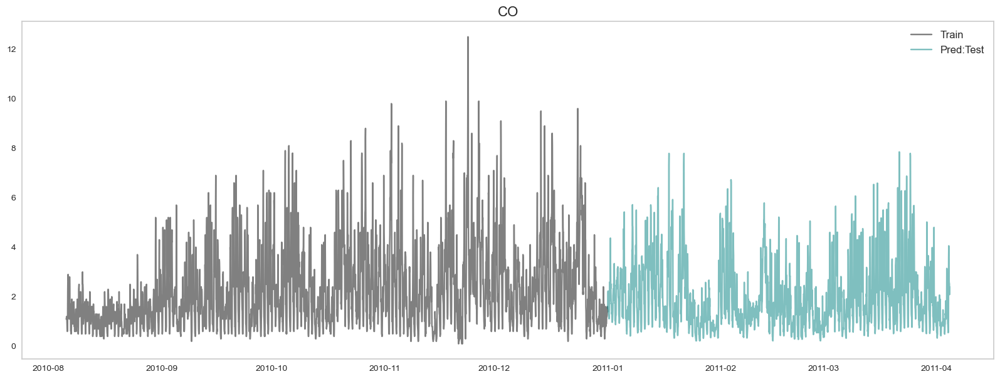

In [114]:
colors = ['teal', 'palevioletred', 'coral']
target_names = ['CO', 'C6H6', 'NOx']

fig, axs = plt.subplots(figsize=(20, 7), ncols=1, nrows=1)
plt.subplots_adjust(hspace = 0.5)

for i in range(1):

    name1 = f'pred_{target_names[i]}'
    name2 = f'val_lgb_{target_names[i]}'
    name3 = f'rmsle_{target_names[i]}'

    axs.plot(df_scaler_val['date_time'], df_scaler_val[targets[i]], color='gray', label='Train')
    #axs.plot(df_scaler_val['date_time'], np.expm1(pred_CO_val), color='yellow', alpha=0.3, label=f'Pred:Val (RMSLE:{rmsle})')
    axs.plot(df_test_scaler['date_time'], pred_CO_test, color=colors[i], alpha=0.5, label='Pred:Test')
    axs.set_title(f'{target_names[i]}', fontsize=16)
    axs.grid(axis='both')
    axs.legend(loc='upper right', fontsize=12)

plt.show()

### C6H6

In [18]:
exp_C6H6 = setup(df, target=targets[1], train_size=0.8, data_split_shuffle=True, fold_shuffle=True, use_gpu=False, ignore_features=[targets[0], targets[2]], categorical_features=categorical_features, session_id=123)


,Description,Value
0,Session id,123
1,Target,target_benzene
2,Target type,Regression
3,Original data shape,"(16089, 24)"
4,Transformed data shape,"(16089, 28)"
5,Transformed train set shape,"(12871, 28)"
6,Transformed test set shape,"(3218, 28)"
7,Ignore features,2
8,Ordinal features,2
9,Numeric features,18


In [19]:
models = compare_models(sort='RMSLE')

,Model,MAE,MSE,RMSE,R2,RMSLE,MAPE,TT (Sec)
catboost,CatBoost Regressor,0.0408,0.0035,0.0590,0.9933,0.0207,0.0242,0.7640
xgboost,Extreme Gradient Boosting,0.0435,0.0039,0.0623,0.9925,0.0219,0.0247,0.0750
lightgbm,Light Gradient Boosting Machine,0.0422,0.0039,0.0628,0.9924,0.0219,0.0240,0.3000
et,Extra Trees Regressor,0.0437,0.0042,0.0648,0.9919,0.0223,0.0233,0.7580
rf,Random Forest Regressor,0.0442,0.0044,0.0661,0.9916,0.0228,0.0238,1.5550
gbr,Gradient Boosting Regressor,0.0433,0.0044,0.0661,0.9916,0.0229,0.0249,0.7390
knn,K Neighbors Regressor,0.0601,0.0065,0.0805,0.9875,0.0288,0.0335,0.0310
ada,AdaBoost Regressor,0.0511,0.0055,0.0744,0.9894,0.0298,0.0506,0.3450
dt,Decision Tree Regressor,0.0623,0.0084,0.0915,0.9839,0.0315,0.0329,0.0470
lr,Linear Regression,0.0971,0.0169,0.1301,0.9675,0.0492,0.0763,0.0260


In [ ]:
C6H6_catboost = create_model('catboost')
C6H6_xgboost = create_model('xgboost')
C6H6_lightgbm = create_model('lightgbm')
C6H6_extratrees= create_model('et')
C6H6_randomforest = create_model('rf')
C6H6_gradientboost = create_model('gbr')

In [ ]:
C6H6_catboost = finalize_model(C6H6_catboost)
C6H6_xgboost = finalize_model(C6H6_xgboost)
C6H6_lightgbm = finalize_model(C6H6_lightgbm)
C6H6_extratrees= finalize_model(C6H6_extratrees)
C6H6_randomforest = finalize_model(C6H6_randomforest)
C6H6_gradientboost = finalize_model(C6H6_gradientboost)

### NOx

In [20]:
exp_NOx = setup(df, target=targets[2], train_size=0.8, data_split_shuffle=True, fold_shuffle=True, use_gpu=False, ignore_features=[targets[1], targets[0]], categorical_features=categorical_features, session_id=123)

,Description,Value
0,Session id,123
1,Target,target_nitrogen_oxides
2,Target type,Regression
3,Original data shape,"(16089, 24)"
4,Transformed data shape,"(16089, 28)"
5,Transformed train set shape,"(12871, 28)"
6,Transformed test set shape,"(3218, 28)"
7,Ignore features,2
8,Ordinal features,2
9,Numeric features,18


In [21]:
models = compare_models(sort='RMSLE')

,Model,MAE,MSE,RMSE,R2,RMSLE,MAPE,TT (Sec)
et,Extra Trees Regressor,0.1053,0.0218,0.1475,0.9718,0.0272,0.0225,0.7900
catboost,CatBoost Regressor,0.1108,0.0226,0.1502,0.9707,0.0275,0.0236,0.8000
xgboost,Extreme Gradient Boosting,0.1209,0.0265,0.1627,0.9657,0.0297,0.0257,0.0890
lightgbm,Light Gradient Boosting Machine,0.1281,0.0302,0.1736,0.9609,0.0320,0.0274,0.3020
rf,Random Forest Regressor,0.1252,0.0301,0.1734,0.9610,0.0323,0.0269,1.6010
gbr,Gradient Boosting Regressor,0.1610,0.0465,0.2155,0.9398,0.0397,0.0345,0.7810
dt,Decision Tree Regressor,0.1770,0.0655,0.2557,0.9152,0.0470,0.0377,0.0550
knn,K Neighbors Regressor,0.2104,0.0869,0.2946,0.8873,0.0527,0.0448,0.0460
ridge,Ridge Regression,0.2311,0.0966,0.3106,0.8750,0.0557,0.0493,0.0240
lr,Linear Regression,0.2312,0.0966,0.3106,0.8750,0.0557,0.0493,0.0300


### lightGBMによる予測（時系列特徴量なし）
CO, C6H6, NOxをそれぞれ個別に予測する

In [6]:
df_val.to_csv('val.csv', index=True)

### Predict CO

In [7]:
train_y_CO = df_train[targets[0]]
train_x_CO = df_train.drop(targets, axis=1)
val_y_CO = df_val[targets[0]]
val_x_CO = df_val.drop(targets, axis=1)

In [8]:

# OptunaによるlightGBMの最適パラメータ探索
def objective(trial):

    lgb_trains = lgb.Dataset(train_x_CO, train_y_CO)
    lgb_valids = lgb.Dataset(val_x_CO, val_y_CO)
    
    learning_rate = trial.suggest_float('learning_rate', 0.0, 1.0)
    num_leaves =  trial.suggest_int('num_leaves', 2, 100)
    tree_learner = trial.suggest_categorical('tree_learner', ['serial', 'feature', 'data', 'voting'])
    lambda_l1= trial.suggest_float('lambda_l1', 0.0, 200.0)
    lambda_l2 = trial.suggest_float('lambda_l2', 0.0, 200.0)
    max_depth = trial.suggest_int('max_depth', 2, 12)
    num_iterations = trial.suggest_int('num_iterations', 10, 100)

    lgb_params = {
        'objective': 'regression',
        'boosting_type': 'gbdt', 
        'metrics': 'rmsle', 
        'learning_rate': learning_rate, 
        'num_leaves': num_leaves, 
        'tree_learner': tree_learner,
        'lambda_l1': lambda_l1, 
        'lambda_l2': lambda_l2, 
        'seed': 123, 
        'max_depth': max_depth,
        'num_iterations': num_iterations,
        'verbose': '-1'      
    }

    regressor = lgb.train(params=lgb_params,
                        train_set=lgb_trains,
                        valid_sets=lgb_valids, 
                        categorical_feature=categorical_features
                        )

    lgb_pred_val_y_CO = regressor.predict(val_x_CO)

    rmsle = np.sqrt(msle(np.expm1(val_y_CO), np.expm1(lgb_pred_val_y_CO).clip(min=0)))
    
    return rmsle

study_CO = optuna.create_study(direction='minimize')
study_CO.optimize(objective, timeout=300)

In [9]:
# Oputunaで求めたパラメーターを使い、COの値を予測
trains = lgb.Dataset(train_x_CO, train_y_CO)
valids = lgb.Dataset(val_x_CO, val_y_CO)

model_lgb_CO = lgb.train(study_CO.best_trial.params, 
                    train_set=trains, 
                    valid_sets=valids, 
                    categorical_feature=categorical_features
                    )

val_lgb_CO = model_lgb_CO.predict(val_x_CO)
rmsle_CO = np.sqrt(msle(np.expm1(val_y_CO), np.expm1(val_lgb_CO).clip(min=0)))

lgb_pred_CO = np.expm1(model_lgb_CO.predict(df_test))

rmsle_CO

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.003795 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 27428
[LightGBM] [Info] Number of data points in the train set: 5688, number of used features: 129
[LightGBM] [Info] Start training from score 1.000200
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf


0.22120248320737204

### Predict C6H6

In [10]:
train_y_C6H6 = df_train[targets[1]]
train_x_C6H6 = df_train.drop(targets, axis=1)
val_y_C6H6 = df_val[targets[1]]
val_x_C6H6 = df_val.drop(targets, axis=1)

In [11]:

# OptunaによるlightGBMの最適パラメータ探索
def objective(trial):

    lgb_trains = lgb.Dataset(train_x_C6H6, train_y_C6H6)
    lgb_valids = lgb.Dataset(val_x_C6H6, val_y_C6H6)
    
    learning_rate = trial.suggest_float('learning_rate', 0.0, 1.0)
    num_leaves =  trial.suggest_int('num_leaves', 2, 100)
    tree_learner = trial.suggest_categorical('tree_learner', ['serial', 'feature', 'data', 'voting'])
    lambda_l1= trial.suggest_float('lambda_l1', 0.0, 200.0)
    lambda_l2 = trial.suggest_float('lambda_l2', 0.0, 200.0)
    max_depth = trial.suggest_int('max_depth', 2, 12)
    num_iterations = trial.suggest_int('num_iterations', 10, 100)

    lgb_params = {
        'objective': 'regression',
        'boosting_type': 'gbdt', 
        'metrics': 'rmsle', 
        'learning_rate': learning_rate, 
        'num_leaves': num_leaves, 
        'tree_learner': tree_learner,
        'lambda_l1': lambda_l1, 
        'lambda_l2': lambda_l2, 
        'seed': 123, 
        'max_depth': max_depth,
        'num_iterations': num_iterations,
        'verbose': '-1'      
    }

    regressor = lgb.train(params=lgb_params,
                        train_set=lgb_trains,
                        valid_sets=lgb_valids, 
                        categorical_feature=categorical_features
                        )

    lgb_pred_val_y_C6H6 = regressor.predict(val_x_C6H6)

    rmsle = np.sqrt(msle(np.expm1(val_y_C6H6), np.expm1(lgb_pred_val_y_C6H6).clip(min=0)))
    
    return rmsle

study_C6H6 = optuna.create_study(direction='minimize')
study_C6H6.optimize(objective, timeout=300)

In [12]:
# Oputunaで求めたパラメーターを使い、C6H6の値を予測
trains = lgb.Dataset(train_x_C6H6, train_y_C6H6)
valids = lgb.Dataset(val_x_C6H6, val_y_C6H6)

model_lgb_C6H6 = lgb.train(study_C6H6.best_trial.params, 
                    train_set=trains, 
                    valid_sets=valids, 
                    categorical_feature=categorical_features
                    )

val_lgb_C6H6 = model_lgb_C6H6.predict(val_x_C6H6)
rmsle_C6H6 = np.sqrt(msle(np.expm1(val_y_C6H6), np.expm1(val_lgb_C6H6).clip(min=0)))

lgb_pred_C6H6 = np.expm1(model_lgb_C6H6.predict(df_test))

rmsle_C6H6

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.003282 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 27428
[LightGBM] [Info] Number of data points in the train set: 5688, number of used features: 129
[LightGBM] [Info] Start training from score 2.190075


0.09777761550935188

### Predict NOx

In [13]:
train_y_NOx = df_train[targets[2]]
train_x_NOx = df_train.drop([*targets, 'sensor_2'], axis=1)
val_y_NOx = df_val[targets[2]]
val_x_NOx = df_val.drop([*targets, 'sensor_2'], axis=1)

In [14]:

# OptunaによるlightGBMの最適パラメータ探索
def objective(trial):

    lgb_trains = lgb.Dataset(train_x_NOx, train_y_NOx)
    lgb_valids = lgb.Dataset(val_x_NOx, val_y_NOx)
    
    learning_rate = trial.suggest_float('learning_rate', 0.0, 1.0)
    num_leaves =  trial.suggest_int('num_leaves', 2, 100)
    tree_learner = trial.suggest_categorical('tree_learner', ['serial', 'feature', 'data', 'voting'])
    lambda_l1= trial.suggest_float('lambda_l1', 0.0, 200.0)
    lambda_l2 = trial.suggest_float('lambda_l2', 0.0, 200.0)
    max_depth = trial.suggest_int('max_depth', 2, 12)
    num_iterations = trial.suggest_int('num_iterations', 10, 100)

    lgb_params = {
        'objective': 'regression',
        'boosting_type': 'gbdt', 
        'metrics': 'rmsle', 
        'learning_rate': learning_rate, 
        'num_leaves': num_leaves, 
        'tree_learner': tree_learner,
        'lambda_l1': lambda_l1, 
        'lambda_l2': lambda_l2, 
        'seed': 123, 
        'max_depth': max_depth,
        'num_iterations': num_iterations,
        'verbose': '-1'      
    }

    regressor = lgb.train(params=lgb_params,
                        train_set=lgb_trains,
                        valid_sets=lgb_valids, 
                        categorical_feature=categorical_features
                        )

    lgb_pred_val_y_NOx = regressor.predict(val_x_NOx)

    rmsle = np.sqrt(msle(np.expm1(val_y_NOx), np.expm1(lgb_pred_val_y_NOx).clip(min=0)))
    
    return rmsle

study_NOx = optuna.create_study(direction='minimize')
study_NOx.optimize(objective, timeout=300)

In [15]:
# Oputunaで求めたパラメーターを使い、NOxの値を予測
trains = lgb.Dataset(train_x_NOx, train_y_NOx)
valids = lgb.Dataset(val_x_NOx, val_y_NOx)

model_lgb_NOx = lgb.train(study_NOx.best_trial.params, 
                    train_set=trains, 
                    valid_sets=valids, 
                    categorical_feature=categorical_features,
                    )

val_lgb_NOx = model_lgb_NOx.predict(val_x_NOx)
rmsle_NOx = np.sqrt(msle(np.expm1(val_y_NOx), np.expm1(val_lgb_NOx).clip(min=0)))

lgb_pred_NOx = np.expm1(model_lgb_NOx.predict(df_test, predict_disable_shape_check=True))

rmsle_NOx

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002617 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 27173
[LightGBM] [Info] Number of data points in the train set: 5688, number of used features: 128
[LightGBM] [Info] Start training from score 4.758380


0.7252171344253587

In [16]:
rmsle_dic =  {'CO':rmsle_CO, 'C6H6':rmsle_C6H6, 'NOx':rmsle_NOx}

print('RMSLE')
print(f'CO: {rmsle_CO}')
print(f'C6H6: {rmsle_C6H6}')
print(f'NOx: {rmsle_NOx}')


RMSLE
CO: 0.22120248320737204
C6H6: 0.09777761550935188
NOx: 0.7252171344253587


In [17]:
test_with_pred = pd.read_csv('test_features_added.csv')

test_with_pred[targets[0]] = lgb_pred_CO
test_with_pred[targets[1]] = lgb_pred_C6H6
test_with_pred[targets[2]] = lgb_pred_NOx

test_with_pred = format_date_time(test_with_pred)


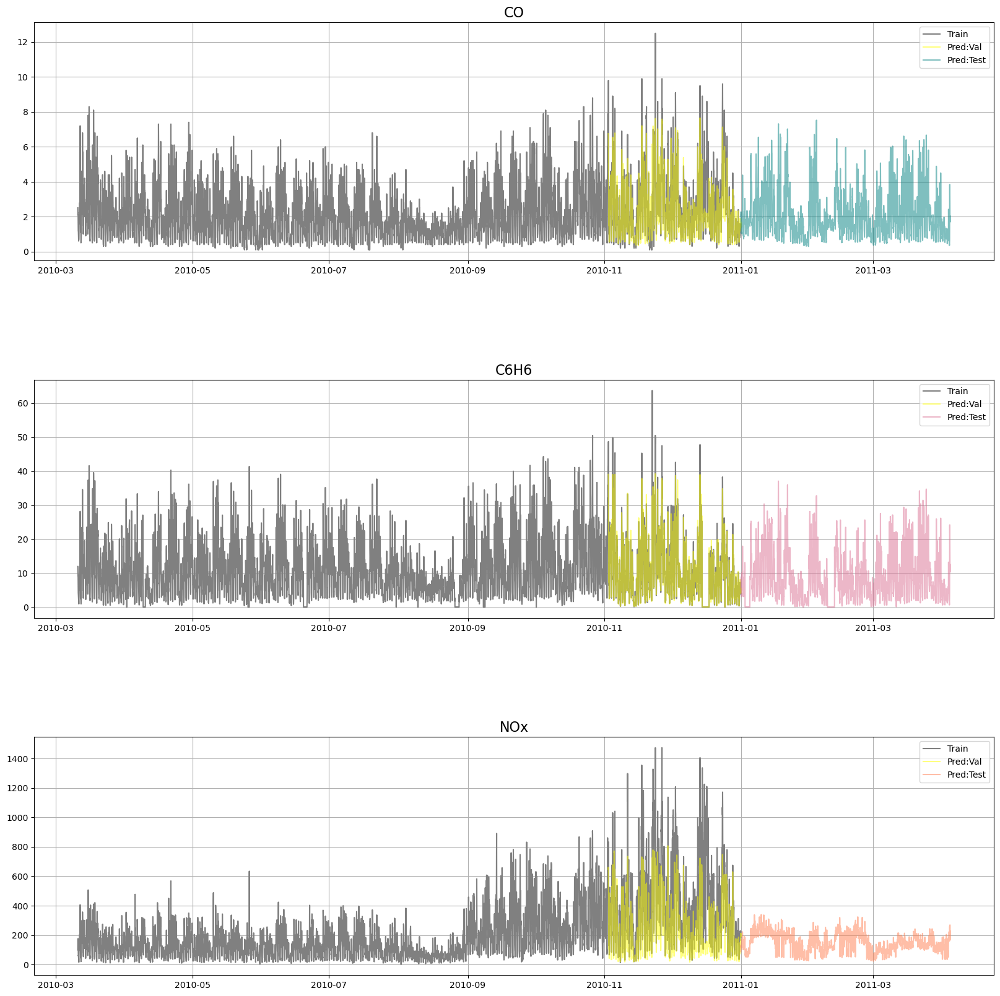

In [18]:
colors = ['teal', 'palevioletred', 'coral']
target_names = ['CO', 'C6H6', 'NOx']

fig, axs = plt.subplots(figsize=(20, 20), ncols=1, nrows=3)
plt.subplots_adjust(hspace = 0.5)

for i in range(3):

    name = f'val_lgb_{target_names[i]}'

    axs[i].plot(df_scaler['date_time'], np.expm1(df[targets[i]]), color='gray', label='Train')
    axs[i].plot(df_scaler_val['date_time'], np.expm1(globals()[name]), color='yellow', alpha=0.5, label='Pred:Val')
    axs[i].plot(test_with_pred['date_time'], test_with_pred[targets[i]], color=colors[i], alpha=0.5, label='Pred:Test')
    axs[i].set_title(f'{target_names[i]}', fontsize=16)
    axs[i].grid(axis='both')
    axs[i].legend(loc='upper right')

plt.show()


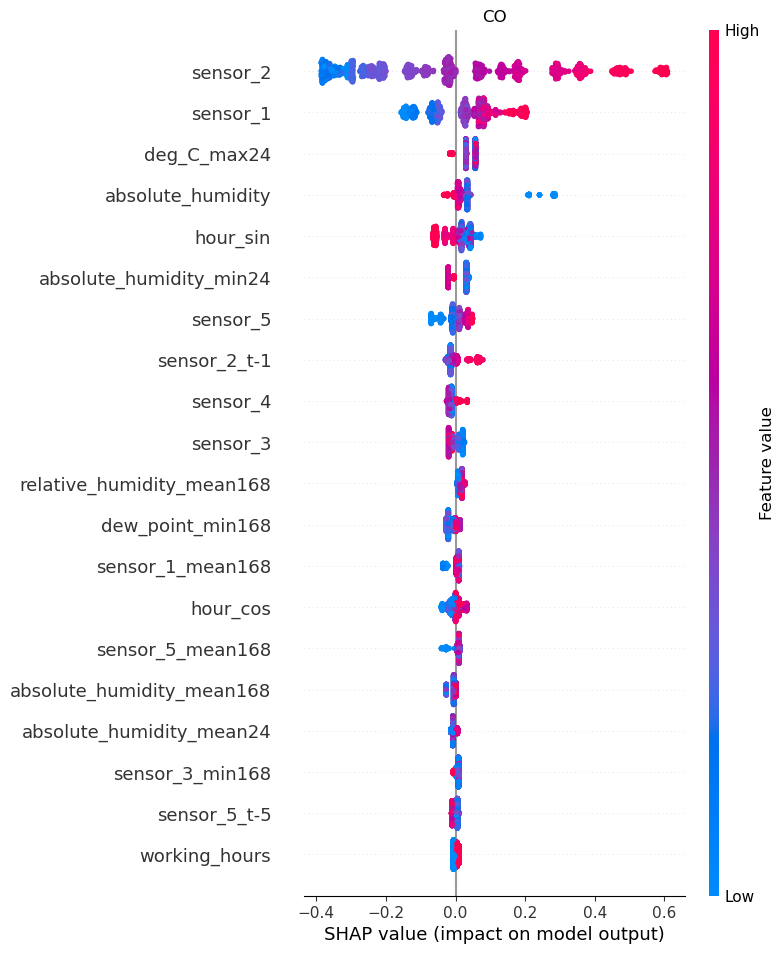

In [19]:
explainer_CO = shap.Explainer(model_lgb_CO)
shap_values_CO = explainer_CO(val_x_CO.reset_index(drop=True))

shap.summary_plot(shap_values_CO, val_x_CO, show=False)
plt.title('CO')
plt.show()

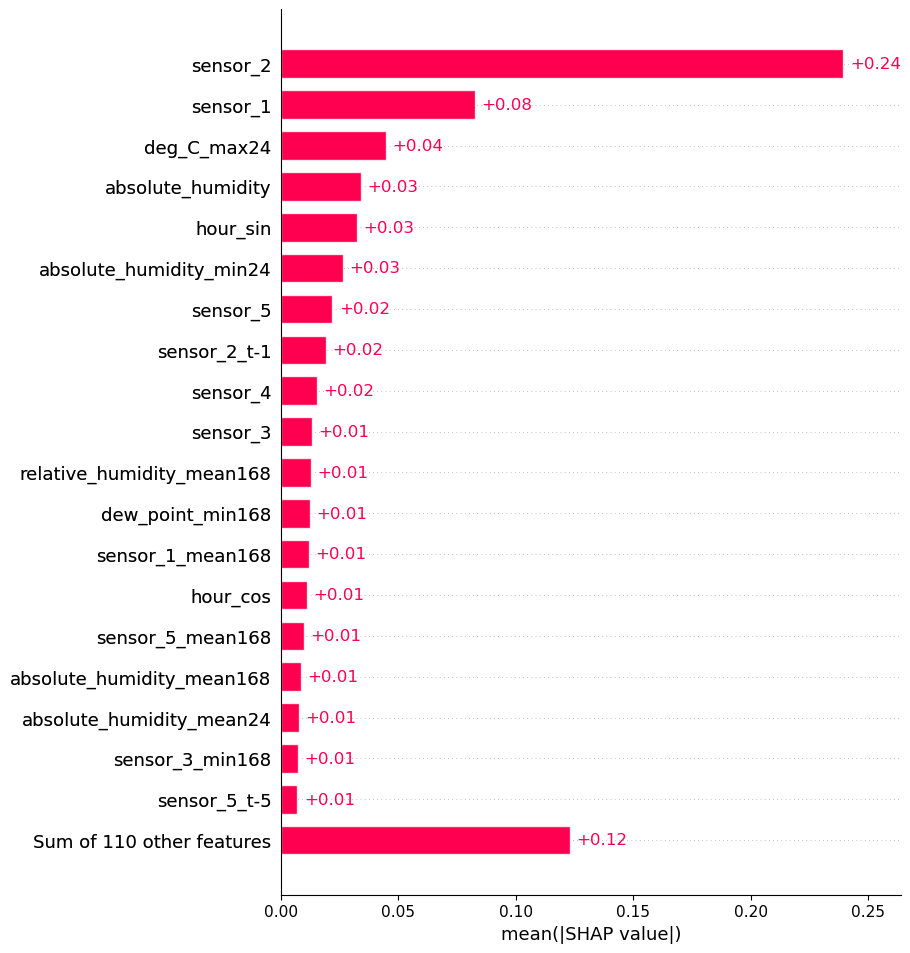

In [20]:
shap.plots.bar(shap_values_CO, max_display=20)
plt.show()

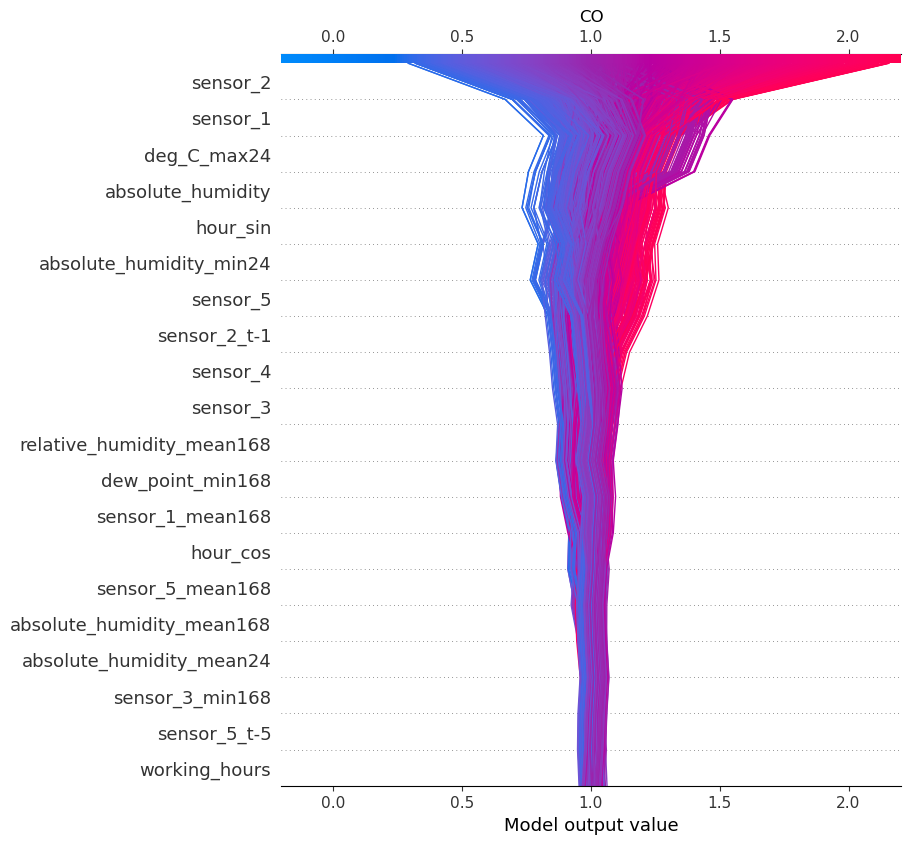

In [21]:
shap.decision_plot(explainer_CO.expected_value, explainer_CO.shap_values(val_x_CO), val_x_CO, show=False)
plt.title('CO')
plt.show()

In [22]:
shap.force_plot(shap_values_CO)

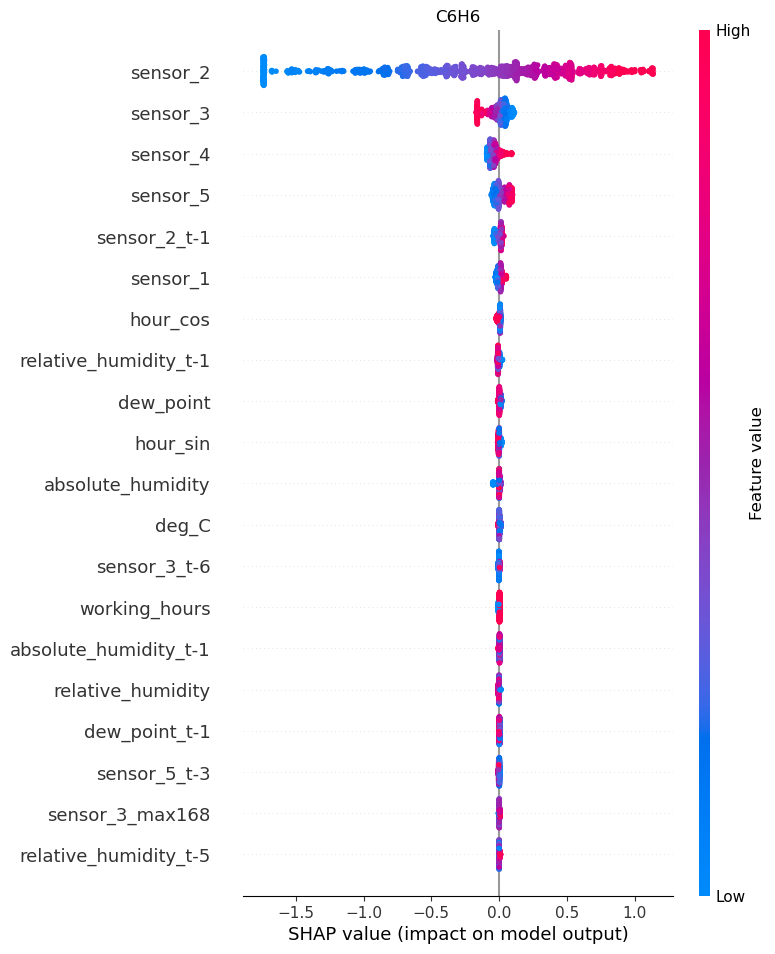

In [23]:
explainer_C6H6 = shap.Explainer(model_lgb_C6H6)
shap_values_C6H6 = explainer_C6H6(val_x_C6H6.reset_index(drop=True))

shap.summary_plot(shap_values_C6H6, val_x_C6H6, show=False)
plt.title('C6H6')
plt.show()

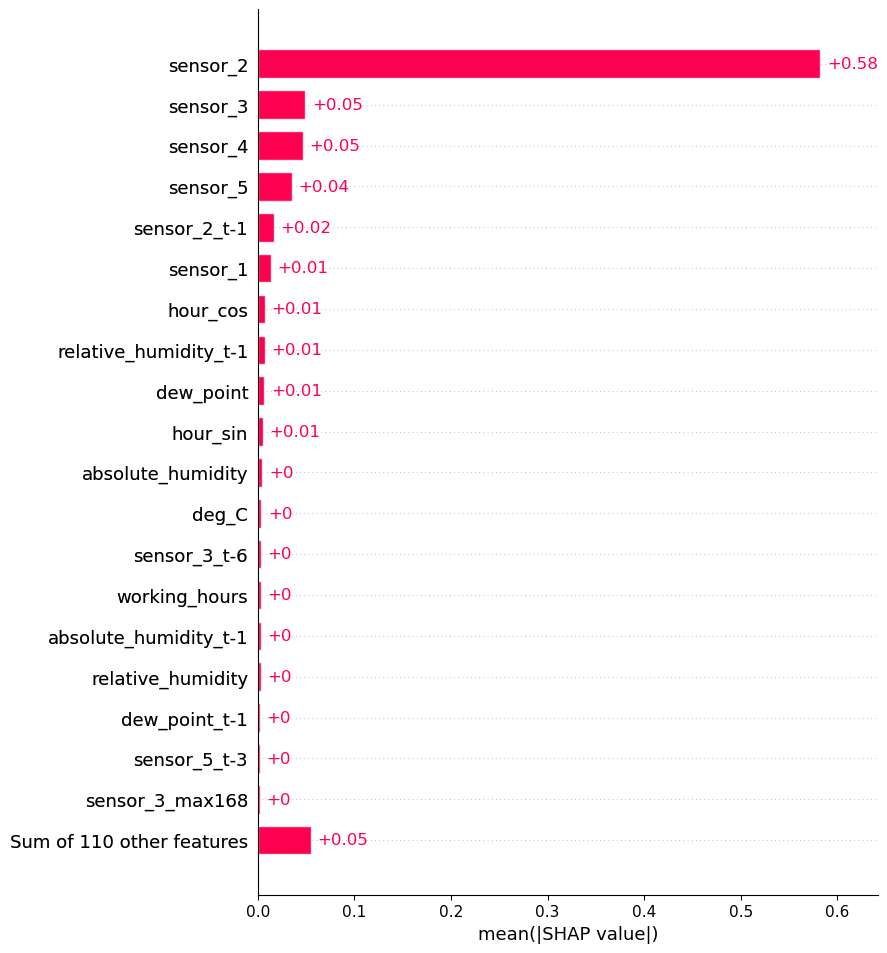

In [24]:
shap.plots.bar(shap_values_C6H6, max_display=20)
plt.show()

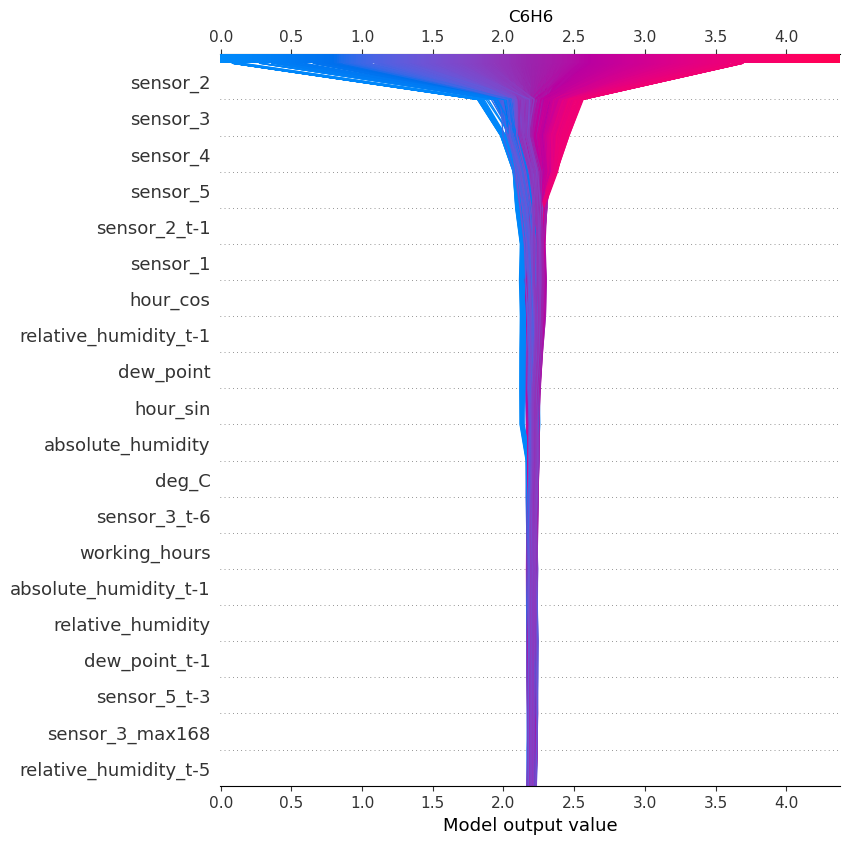

In [25]:
shap.decision_plot(explainer_C6H6.expected_value, explainer_C6H6.shap_values(val_x_C6H6), val_x_C6H6, show=False)
plt.title('C6H6')
plt.show()

In [26]:
shap.force_plot(shap_values_C6H6)

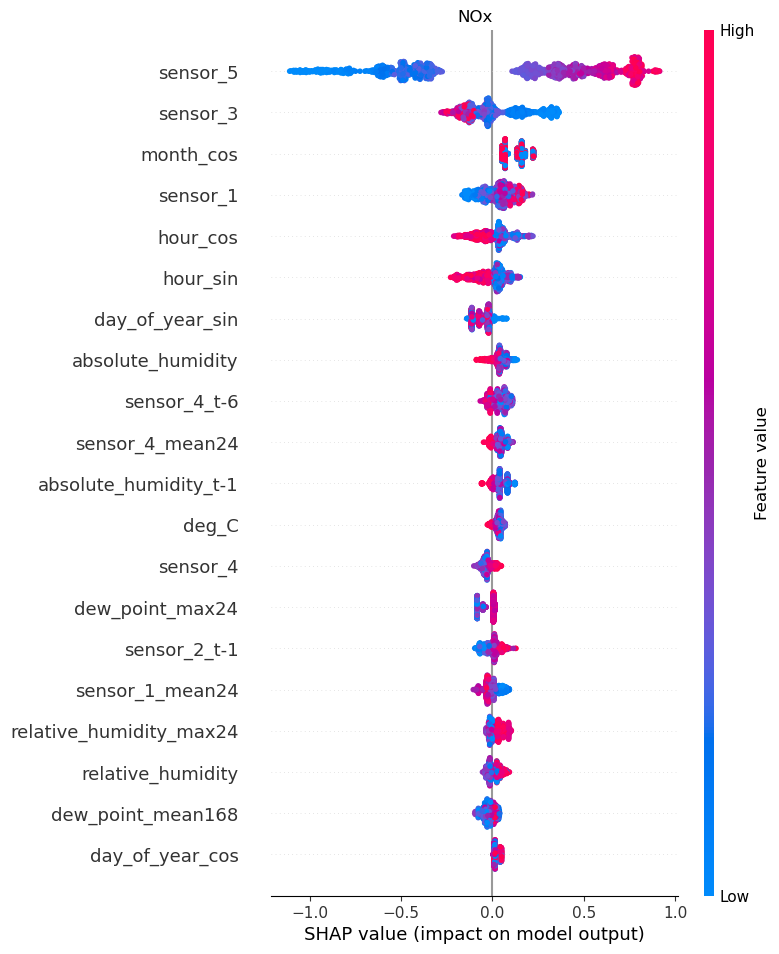

In [27]:
explainer_NOx = shap.Explainer(model_lgb_NOx)
shap_values_NOx = explainer_NOx(val_x_NOx.reset_index(drop=True))

shap.summary_plot(shap_values_NOx, val_x_NOx, show=False)
plt.title('NOx')
plt.show()

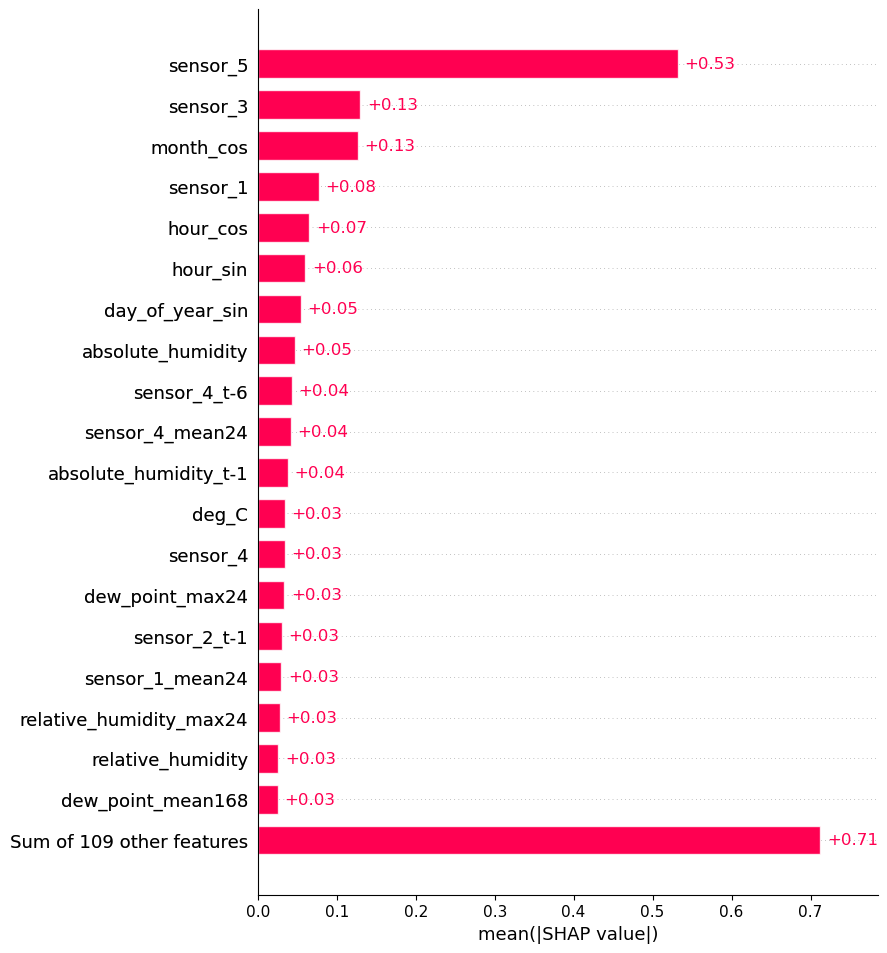

In [28]:
shap.plots.bar(shap_values_NOx, max_display=20)
plt.show()

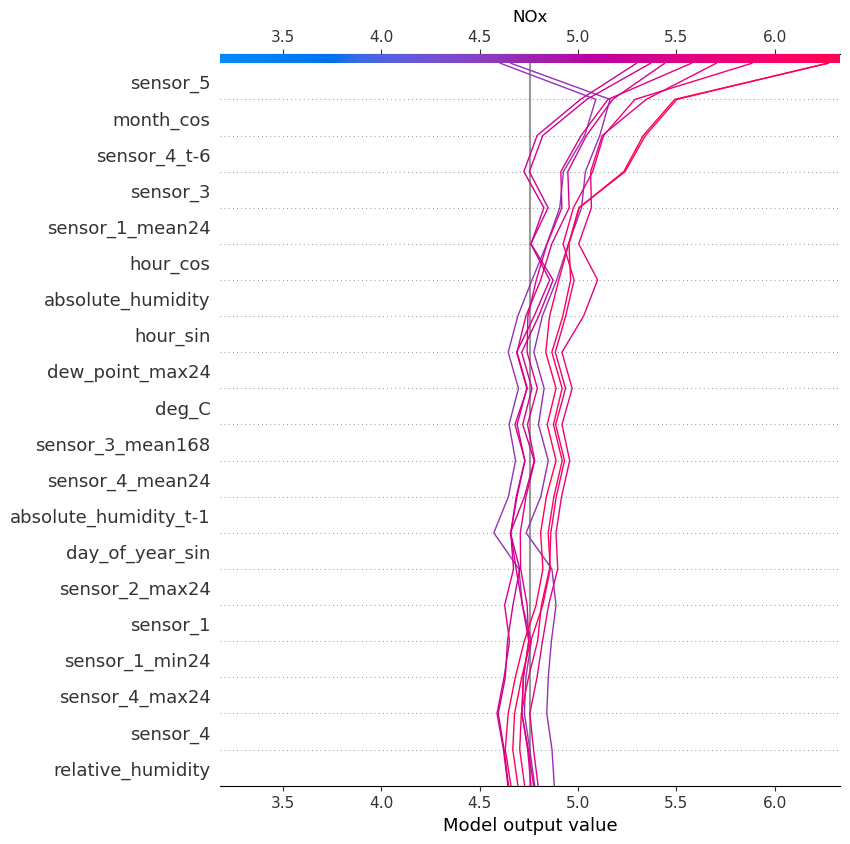

In [29]:
shap.decision_plot(explainer_NOx.expected_value, explainer_NOx.shap_values(val_x_NOx)[140:150], val_x_NOx, show=False)
plt.title('NOx')
plt.show()

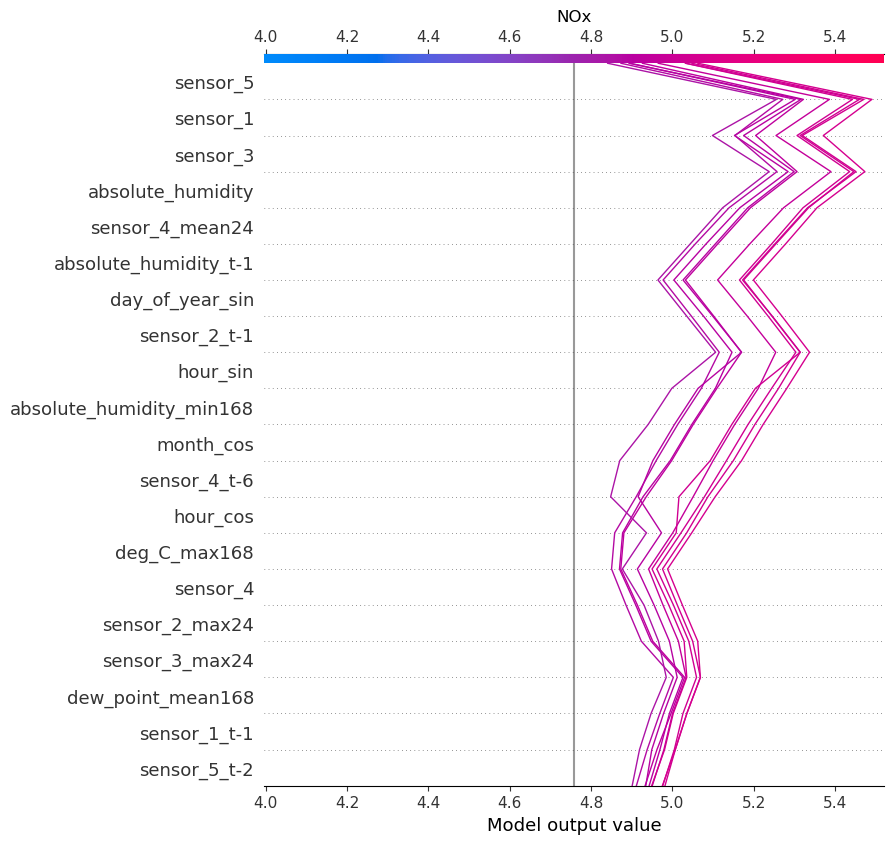

In [30]:
shap.decision_plot(explainer_NOx.expected_value, explainer_NOx.shap_values(val_x_NOx)[1050:1060], val_x_NOx, show=False)
plt.title('NOx')
plt.show()

In [31]:
shap.force_plot(shap_values_NOx)

### テストデータを全部学習させて最終結果を得る

In [32]:
df_train_y_CO = df[targets[0]]
df_train_x_CO = df.drop(targets, axis=1)

df_train_y_C6H6 = df[targets[1]]
df_train_x_C6H6 = df.drop(targets, axis=1)

df_train_y_NOx = df[targets[2]]
df_train_x_NOx = df.drop(targets, axis=1)

#df_test.set_index('date_time', inplace=True)


In [33]:
# Oputunaで求めたパラメーターを使い、COの値を予測
trains = lgb.Dataset(df_train_x_CO, df_train_y_CO)

model_lgb_CO_final = lgb.train(study_CO.best_trial.params, 
                    train_set=trains,
                    categorical_feature=categorical_features,
                    init_model=model_lgb_CO
                    )

pred_CO = np.expm1(model_lgb_CO_final.predict(df_test)).clip(min=0)

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.005711 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 27917
[LightGBM] [Info] Number of data points in the train set: 7111, number of used features: 129


In [34]:
# Oputunaで求めたパラメーターを使い、C6H6の値を予測
trains = lgb.Dataset(df_train_x_C6H6, df_train_y_C6H6)

model_lgb_C6H6_final = lgb.train(study_C6H6.best_trial.params, 
                    train_set=trains,
                    categorical_feature=categorical_features,
                    init_model=model_lgb_C6H6
                    )

pred_C6H6 = np.expm1(model_lgb_C6H6_final.predict(df_test)).clip(min=0)

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.003690 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 27917
[LightGBM] [Info] Number of data points in the train set: 7111, number of used features: 129


In [35]:
df_train_x_NOx = df_train_x_NOx.drop(['sensor_2'], axis=1)

In [36]:
# Oputunaで求めたパラメーターを使い、NOxの値を予測
trains = lgb.Dataset(df_train_x_NOx, df_train_y_NOx)

model_lgb_NOx_final = lgb.train(study_NOx.best_trial.params, 
                    train_set=trains,
                    categorical_feature=categorical_features,
                    init_model=model_lgb_NOx)

pred_NOx = np.expm1(model_lgb_NOx_final.predict(df_test, predict_disable_shape_check=True)).clip(min=0)

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.003557 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 27662
[LightGBM] [Info] Number of data points in the train set: 7111, number of used features: 128
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf


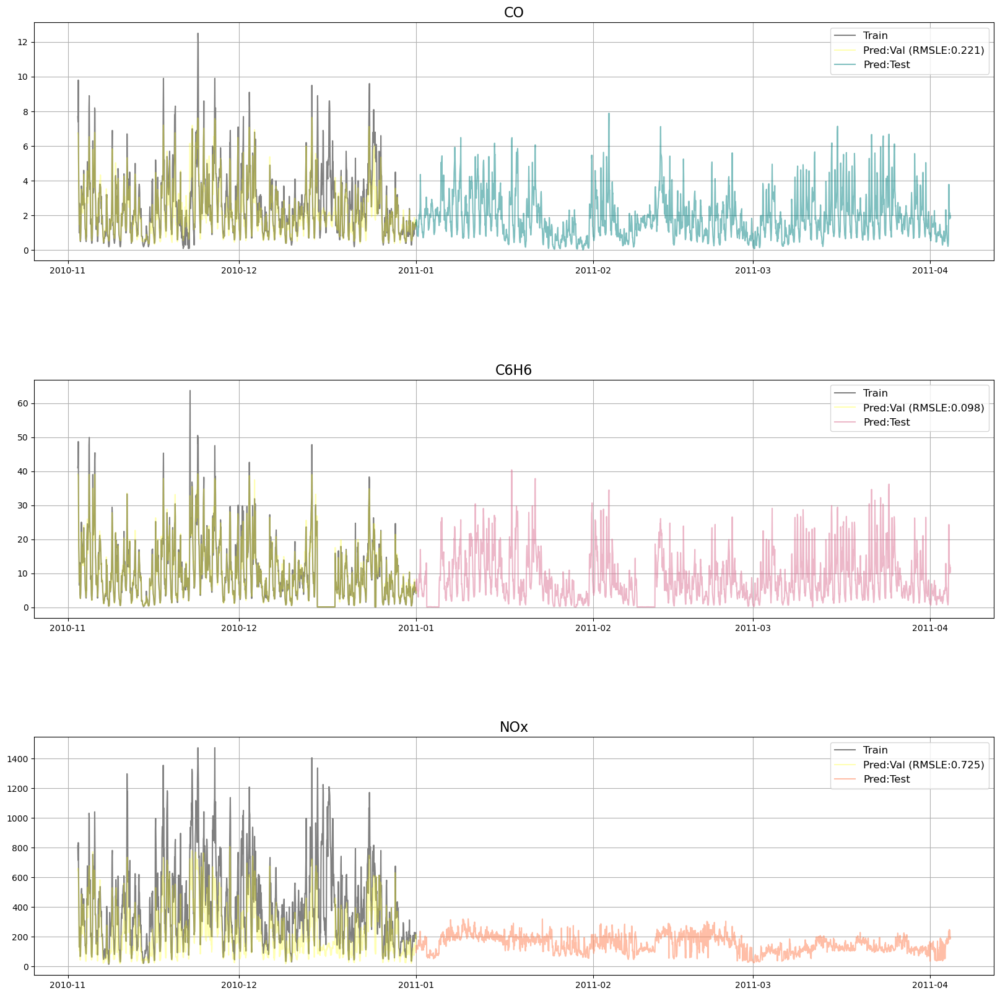

In [37]:
fig, axs = plt.subplots(figsize=(20, 20), ncols=1, nrows=3)
plt.subplots_adjust(hspace = 0.5)

for i in range(3):

    name1 = f'pred_{target_names[i]}'
    name2 = f'val_lgb_{target_names[i]}'
    name3 = f'rmsle_{target_names[i]}'

    axs[i].plot(df_scaler_val['date_time'], np.expm1(df_val[targets[i]]), color='gray', label='Train')
    axs[i].plot(df_scaler_val['date_time'], np.expm1(globals()[name2]), color='yellow', alpha=0.3, label=f'Pred:Val (RMSLE:{globals()[name3]:.3f})')
    axs[i].plot(df_test_scaler['date_time'], globals()[name1], color=colors[i], alpha=0.5, label='Pred:Test')
    axs[i].set_title(f'{target_names[i]}', fontsize=16)
    axs[i].grid(axis='both')
    axs[i].legend(loc='upper right', fontsize=12)

plt.show()

In [38]:
df_scaler_val = df_scaler_val.reset_index()

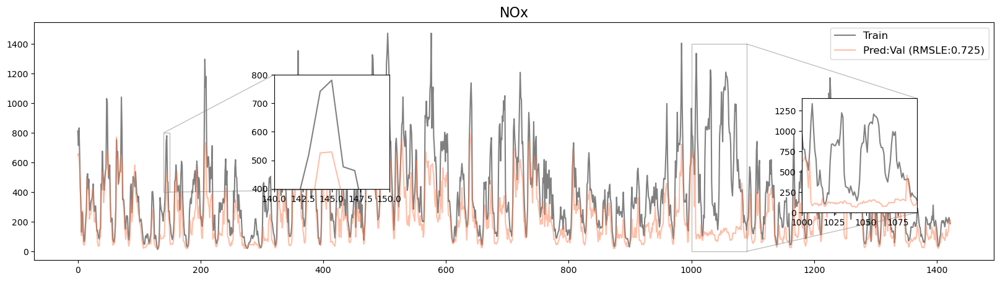

In [39]:
fig, axs = plt.subplots(figsize=(20, 5), ncols=1, nrows=1)
plt.subplots_adjust(hspace = 0.5)

name1 = f'pred_{target_names[2]}'
name2 = f'val_lgb_{target_names[2]}'
name3 = f'rmsle_{target_names[2]}'

axs.plot(df_scaler_val.index, np.expm1(df_val[targets[i]]), color='gray', label='Train')
axs.plot(df_scaler_val.index, np.expm1(globals()[name2]), color=colors[2], alpha=0.5, label=f'Pred:Val (RMSLE:{globals()[name3]:.3f})')

axins1 = axs.inset_axes([0.25, 0.3, 0.12, 0.48])
axins1.plot(df_scaler_val.index, np.expm1(df_val[targets[i]]), color='gray')
axins1.plot(df_scaler_val.index, np.expm1(globals()[name2]), color=colors[2], alpha=0.5)
x11, x12, y11, y12 = 140, 150, 400, 800
axins1.set_xlim(x11, x12)
axins1.set_ylim(y11, y12)
axs.indicate_inset_zoom(axins1)

axins2 = axs.inset_axes([0.8, 0.2, 0.12, 0.48])
axins2.plot(df_scaler_val.index, np.expm1(df_val[targets[i]]), color='gray')
axins2.plot(df_scaler_val.index, np.expm1(globals()[name2]), color=colors[2], alpha=0.5)
x21, x22, y21, y22 = 1000, 1090, 0, 1400
axins2.set_xlim(x21, x22)
axins2.set_ylim(y21, y22)
axs.indicate_inset_zoom(axins2)

axs.set_title(f'{target_names[i]}', fontsize=16)
#axs.grid(axis='both')
axs.legend(loc='upper right', fontsize=12)

In [40]:
submit_base = pd.read_csv('sample_submission.csv')

submit = pd.DataFrame()

submit['date_time'] = submit_base['date_time']
submit[targets[0]] = pred_CO
submit[targets[1]] = pred_C6H6
submit[targets[2]] = pred_NOx

submit.to_csv('submission_lgbm_NOx_without_sensor2.csv', index=False)


### Kaggle score
    - Private: 0.28614
    - Public: 0.36329
    - 1144/1293